#  STAT 301  
# Final Report

## Melbourne Housing Market

**Load the necessary packages** for our data analysis.

In [1]:
library(tidyverse)
library(repr)
library(infer)
library(cowplot)
library(dplyr)
library(broom)
library(ggplot2)
library(GGally)
library(MASS)
library(rsample)
library(leaps)


── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.3     ✔ readr     2.1.4
✔ forcats   1.0.0     ✔ stringr   1.5.0
✔ ggplot2   3.4.3     ✔ tibble    3.2.1
✔ lubridate 1.9.3     ✔ tidyr     1.3.0
✔ purrr     1.0.2     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors

Attaching package: ‘cowplot’


The following object is masked from ‘package:lubridate’:

    stamp


Registered S3 method overwritten by 'GGally':
  method from   
  +.gg   ggplot2


Attaching package: ‘MASS’


The following object is masked from ‘package:dplyr’:

    select




## Data

We read the data into R from the web 

In [2]:
data <- read.csv("https://raw.githubusercontent.com/HelenXuanye-He/STATS-301-PROJECT/31530efd259e32800656c74548b51d5070896578/Melbourne_housing_FULL.csv")
head(data)



,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,⋯,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
,<chr>,<chr>,<int>,<chr>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<int>,<int>,<int>,<dbl>,<int>,<chr>,<dbl>,<dbl>,<chr>,<chr>
1,Abbotsford,68 Studley St,2,h,NA,SS,Jellis,3/09/2016,2.5,3067,⋯,1,1,126,NA,NA,Yarra City Council,-37.8014,144.9958,Northern Metropolitan,4019
2,Abbotsford,85 Turner St,2,h,1480000,S,Biggin,3/12/2016,2.5,3067,⋯,1,1,202,NA,NA,Yarra City Council,-37.7996,144.9984,Northern Metropolitan,4019
3,Abbotsford,25 Bloomburg St,2,h,1035000,S,Biggin,4/02/2016,2.5,3067,⋯,1,0,156,79,1900,Yarra City Council,-37.8079,144.9934,Northern Metropolitan,4019
4,Abbotsford,18/659 Victoria St,3,u,NA,VB,Rounds,4/02/2016,2.5,3067,⋯,2,1,0,NA,NA,Yarra City Council,-37.8114,145.0116,Northern Metropolitan,4019
5,Abbotsford,5 Charles St,3,h,1465000,SP,Biggin,4/03/2017,2.5,3067,⋯,2,0,134,150,1900,Yarra City Council,-37.8093,144.9944,Northern Metropolitan,4019
6,Abbotsford,40 Federation La,3,h,850000,PI,Biggin,4/03/2017,2.5,3067,⋯,2,1,94,NA,NA,Yarra City Council,-37.7969,144.9969,Northern Metropolitan,4019


# Introduction

The link to access the dataset through Kaggle: https://www.kaggle.com/datasets/anthonypino/melbourne-housing-market . 

The dataset "Melbourne Housing Market" sourced from Kaggle which captures a snapshot of house trades in Melbourne during 2016 to early 2018 known as house price bubble period. In that period, Melbourne’s traded houses’ prices were experiencing tremendous changes: first rose in an abnormal way, followed by a rapid decline. 

In this project, we will predominantly conducting predictive analysis to determine the specific factors that exert the most influence on property prices within the Melbourne housing market during the 16-18 bubble period. On top of this, we could also constructing inferential analysis to assess the impact of multiple factors on the house price simultaneously by using Multiple Linear Regression model. 

After a preliminary data cleaning phase, where we omitted the missing values in the explanatory variables:  `Car`, `Price`, `Distance`, `Bedroom2` and `Bathroom`, the effective population size (N) for this study stands at 20,423 traded houses. This refined dataset serves as the basis for the subsequent predictive modeling.


### Research Question 
How does the house prices (response variable) and the distance from the Melbourne CBD, the number of bathrooms, the number of bedrooms and the number of car spots (explanatory variables) correlated in Melbourne's housing market, and how does the explanatory variables collectively provide a better prediction of house prices?

### References 

######aaaaa



## Variables 

|Variable Name|Description|Variable Type|
|-------------|-----------|----|
|`Price`|The price of the property in Australian dollars|Numerical variable|
|`Type`|The type of property: h,u,t. Where h stands for houses, cottages, villas, semis, terraces; u stands for apartments, duplex; t stands for townhouses|Categorical variable|
|`Method`| Methods of sale ,S - property sold; SP - property sold prior; PI - property passed in; PN - sold prior not disclosed; SN - sold not disclosed; NB - no bid; VB - vendor bid; W - withdrawn prior to auction; SA - sold after auction; SS - sold after auction price not disclosed | Categorical variable|
|`Distance`| The distance from the property to the Central Business District (CBD) of Melbourne, measured in kilometers| Numerical variable|
|`Rooms`| Number of rooms in the house| Numerical variable|
|`Bedroom2`| Number of bedrooms in the house | Numerical variable|
|`Bathroom`| Number of bathrooms in the house| Numerical variable|
|`Car`| Number of car spots| Numerical variable|
|`landsize`| Land Size in Metres| Numerical variable|
|`BuildingArea`| Building Size in Metres|Numerical variable|
|`YearBuilt`| Year the house was built|Numerical variable|

# Methods and Results

### a) Exploratory Data Analysis

Before proceeding with the data analysis, it is crucial to ensure that there are no missing values in the variables of interest. The explanatory variables we are focusing on for our analysis include `Car`, `Distance`, `Bedroom2`, and `Bathroom`,as well as the response variable `Price`.

In [3]:
housing <- dplyr::select(data,Price,Car,Distance,Bedroom2,Bathroom)%>%na.omit()

housing$Price <-as.double(housing$Price)
housing$Distance<-as.double(housing$Distance)


head(housing)
nrow(housing)

,Price,Car,Distance,Bedroom2,Bathroom
,<dbl>,<int>,<dbl>,<int>,<int>
2,1480000,1,2.5,2,1
3,1035000,0,2.5,2,1
5,1465000,0,2.5,3,2
6,850000,1,2.5,3,2
7,1600000,2,2.5,3,1
11,941000,0,2.5,2,1


[1] 20423

We are going to do single variable scatter plots for each individual explanatory variables, which offering valuable insights about the distribution and variability for each variable. 

`geom_smooth()` using formula = 'y ~ x'


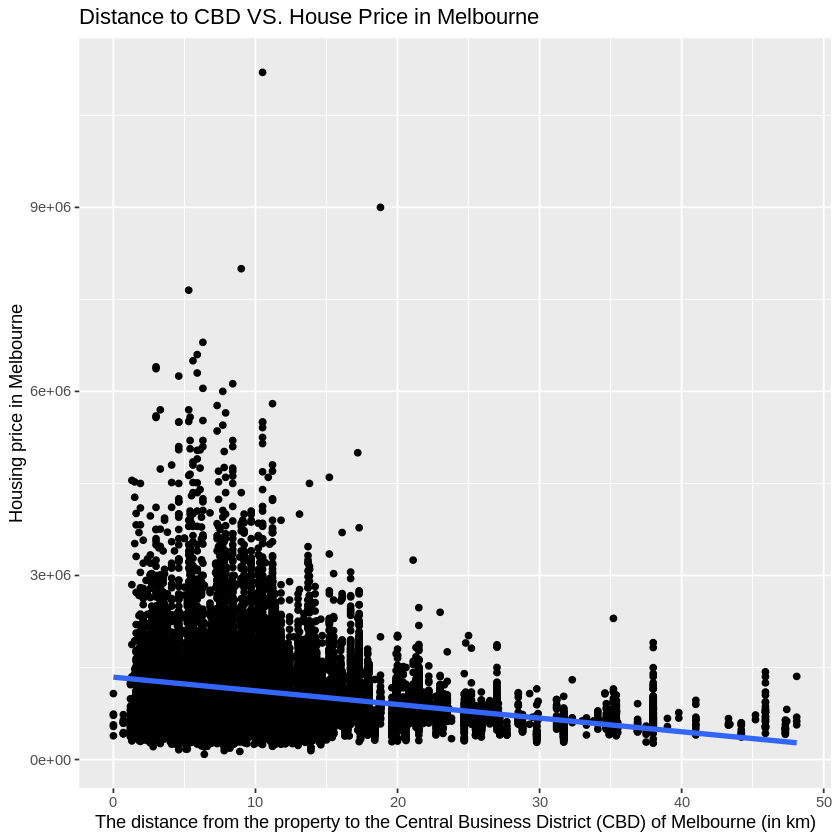

In [4]:
PriceVSDistance <- ggplot(data=housing, aes(x=Distance, y=Price)) + 
    geom_point() + 
    geom_smooth(method = lm, se = FALSE, linewidth = 1.5) +
    xlab("The distance from the property to the Central Business District (CBD) of Melbourne (in km)")+
    ylab("Housing price in Melbourne")+
    ggtitle("Distance to CBD VS. House Price in Melbourne")
PriceVSDistance

In [5]:
cor(housing$Price, housing$Distance)

[1] -0.233206

Comments:

1. There is clear decreasing trend. When the distance from the property to the Central Business District (CBD) of Melbourne increases, the housing price tends to decrease. 
2. The linear correlation between the variable price and distance is -0.2194. Thus there is a weak linear relationship between variable price and distance in a neagive association. 
3. From the trend in the plot above, it agrees with our common sense that houses close to CBD are usually more expensive than the ones away from CBD. Thus we thinks this is a good predictor from our logic. However, there will be some expections. 

`geom_smooth()` using formula = 'y ~ x'


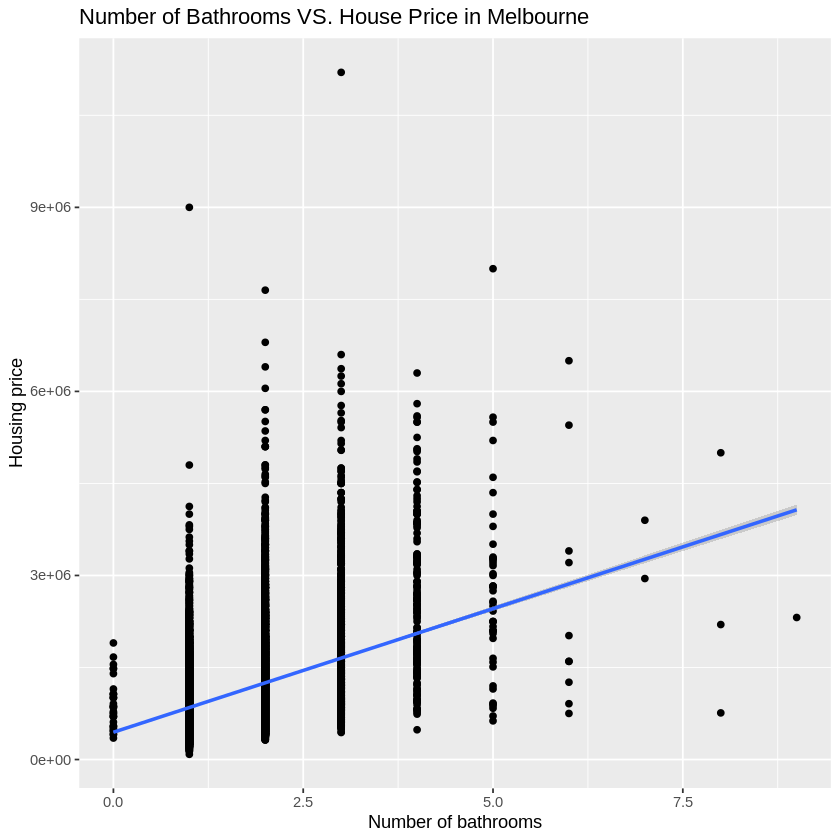

In [6]:
PriceVSBathroom <- ggplot(data=housing, aes(x=Bathroom, y=Price)) + 
    geom_point() + 
    geom_smooth(method = "lm") +
    xlab("Number of bathrooms")+
    ylab("Housing price")+
    ggtitle("Number of Bathrooms VS. House Price in Melbourne")
PriceVSBathroom

In [7]:
cor(housing$Price, housing$Bathroom)

[1] 0.4321887

Comments:

1. There is clear increasing trend. When the number of bathrooms in house increases, the housing price tends to increase. 
2. The linear correlation between the variable price and distance is 0.4372. Thus there is a moderate linear relationship between variable price and Bathroom in a positive association. 
3. From the trend in the plot above, it agrees with our common sense that houses with more bathrooms are usually more expensive than the ones have less bathrooms. However, there will be some expections. 

`geom_smooth()` using formula = 'y ~ x'


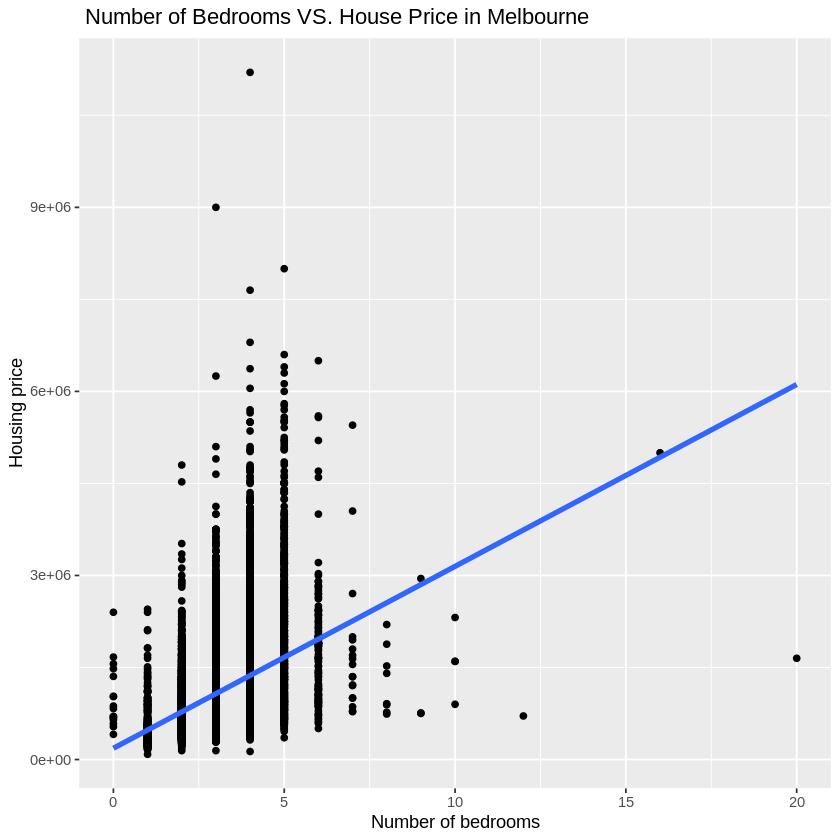

In [8]:
PriceVSBedroom <- ggplot(data=housing, aes(x=Bedroom2, y=Price)) + 
    geom_point() + 
    geom_smooth(method = lm, se = FALSE, linewidth = 1.5) +
    xlab("Number of bedrooms")+
    ylab("Housing price")+
    ggtitle(" Number of Bedrooms VS. House Price in Melbourne")
PriceVSBedroom

In [9]:
cor(housing$Price, housing$Bedroom2)

[1] 0.4328878

Comments:

1. There is clear increasing trend. When the number of bedrooms in house increases, the housing price tends to increase.
2. The linear correlation between the variable price and distance is 0.4355. Thus there is a moderate linear relationship between variable price and Bedroom in a positive association.
3. The data points clustered at the lower number of bedrooms, and more spread out at the number >8 bedrooms in the house. There's a wide variability in price for houses with the same number of bedrooms, espcially for 4-5 bedrooms. The fitted linear regression line does not capture the variability of the data points perfectly.
4.  From the trend in the plot above, it agrees with our common sense that houses with more bedrooms are usually more expensive than the ones have less bedrooms. However, there will be some expections. 

`geom_smooth()` using formula = 'y ~ x'


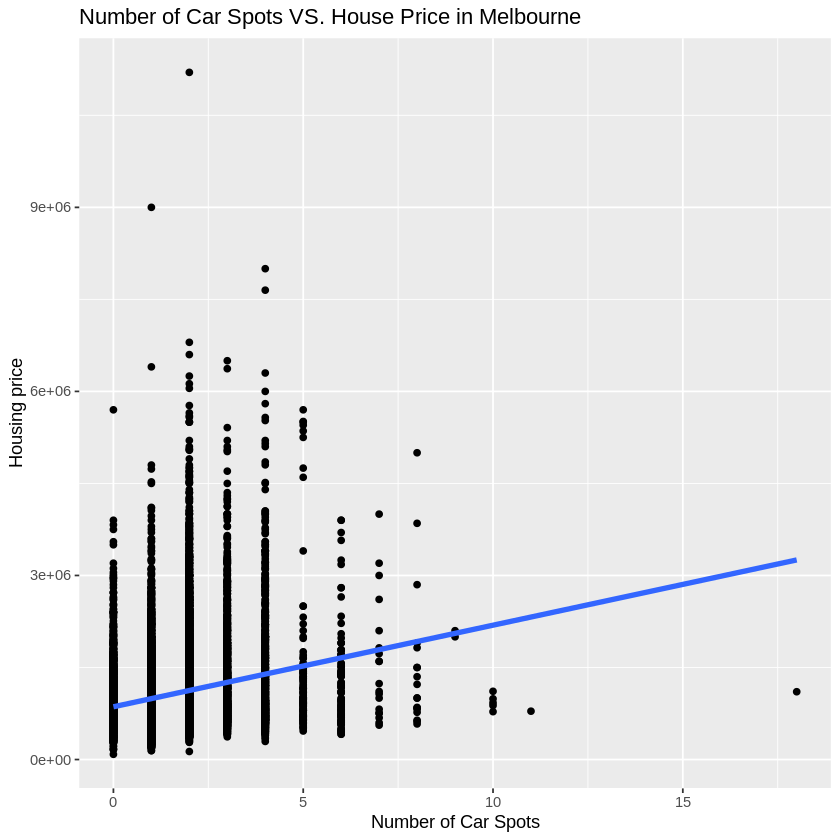

In [10]:
PriceVSCar <- ggplot(data=housing, aes(x=Car, y=Price)) + 
    geom_point() + 
    geom_smooth(method = lm, se = FALSE, linewidth = 1.5) +
    xlab("Number of Car Spots")+
    ylab("Housing price")+
    ggtitle("Number of Car Spots VS. House Price in Melbourne")
PriceVSCar

In [11]:
cor(housing$Price, housing$Car)

[1] 0.2018026

Comments:

1. There is clear increasing trend. When the number of car spots in house increases, the housing price tends to increase.
2. The linear correlation between the variable price and distance is 0.2017. Thus there is a weak linear relationship between variable price and Car in a positive association.
3. There are many outliers, especially at lower numbers of car spots.

In [ ]:
housing%>%ggpairs()

### b) Methods: Plan

**Implementation of a proposed model**

In [12]:
model <- lm(Price ~ Distance + Bathroom + Bedroom2 + Car, data = housing)
model


Call:
lm(formula = Price ~ Distance + Bathroom + Bedroom2 + Car, data = housing)

Coefficients:
(Intercept)     Distance     Bathroom     Bedroom2          Car  
     302557       -37010       223860       250243        51566  


In [13]:
summary(model)


Call:
lm(formula = Price ~ Distance + Bathroom + Bedroom2 + Car, data = housing)

Residuals:
     Min       1Q   Median       3Q      Max 
-3640221  -314248   -93025   216418  9510363 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept) 302557.1    12696.5   23.83   <2e-16 ***
Distance    -37009.9      560.2  -66.07   <2e-16 ***
Bathroom    223859.8     6553.5   34.16   <2e-16 ***
Bedroom2    250243.2     5092.6   49.14   <2e-16 ***
Car          51566.2     4057.3   12.71   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 520700 on 20418 degrees of freedom
Multiple R-squared:  0.3683,	Adjusted R-squared:  0.3681 
F-statistic:  2976 on 4 and 20418 DF,  p-value: < 2.2e-16


In [14]:
full.model <- lm(Price ~ ., data = housing)

In [15]:
stepwise.model <- stepAIC(full.model, direction = "both")

Start:  AIC=537657.6
Price ~ Car + Distance + Bedroom2 + Bathroom

           Df  Sum of Sq        RSS    AIC
<none>                   5.5358e+15 537658
- Car       1 4.3794e+13 5.5796e+15 537816
- Bathroom  1 3.1635e+14 5.8521e+15 538791
- Bedroom2  1 6.5466e+14 6.1904e+15 539938
- Distance  1 1.1834e+15 6.7192e+15 541612


In [16]:
summary(stepwise.model)


Call:
lm(formula = Price ~ Car + Distance + Bedroom2 + Bathroom, data = housing)

Residuals:
     Min       1Q   Median       3Q      Max 
-3640221  -314248   -93025   216418  9510363 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept) 302557.1    12696.5   23.83   <2e-16 ***
Car          51566.2     4057.3   12.71   <2e-16 ***
Distance    -37009.9      560.2  -66.07   <2e-16 ***
Bedroom2    250243.2     5092.6   49.14   <2e-16 ***
Bathroom    223859.8     6553.5   34.16   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 520700 on 20418 degrees of freedom
Multiple R-squared:  0.3683,	Adjusted R-squared:  0.3681 
F-statistic:  2976 on 4 and 20418 DF,  p-value: < 2.2e-16


In [17]:
set.seed(1234)
Housing_split <- initial_split(housing, prop = 0.7, strata = Price)
training_Housing <- training(Housing_split)
testing_Housing <- testing(Housing_split)

Housing_stepwise <- regsubsets(
  x = Price ~ Distance*Bedroom2*Bathroom*Car,  
  data = training_Housing,
  method = "seqrep",  
)

housing_stepwise_summary <- summary(Housing_stepwise)

In [18]:
housing_stepwise_summary_df <- tibble(
    RSQ = housing_stepwise_summary$rsq,
    RSS = housing_stepwise_summary$rss,
    ADJ.R2 = housing_stepwise_summary$adjr2,
    Cp = housing_stepwise_summary$cp,
    BIC = housing_stepwise_summary$bic
)
housing_stepwise_summary_df

RSQ,RSS,ADJ.R2,Cp,BIC
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
0.2123324,4.864467e+15,0.2122773,4774.56394,-3392.782
0.3602500,3.950960e+15,0.3601605,1196.20435,-6356.557
0.3898978,3.767861e+15,0.3897698,480.57680,-7025.301
0.3951712,3.735294e+15,0.3950019,354.93524,-7139.828
0.4003017,3.703609e+15,0.4000919,232.74965,-7252.037
0.4025838,3.689515e+15,0.4023329,179.51149,-7296.971
0.4054376,3.671891e+15,0.4051463,112.43432,-7355.853
0.4075931,3.658579e+15,0.4072613,62.26155,-7398.203


In [19]:
cp_min = which.min(housing_stepwise_summary$cp) 
selected_var <- names(coef(Housing_stepwise, cp_min))[-1]
selected_var

[1] "Distance"              "Bedroom2"              "Car"                  
[4] "Distance:Bedroom2"     "Distance:Bathroom"     "Bedroom2:Bathroom"    
[7] "Bathroom:Car"          "Bedroom2:Bathroom:Car"

In [20]:
model <- lm(Price ~ Bedroom2 +Bedroom2:Bathroom +Bathroom:Car + 
            Distance:Bedroom2:Bathroom+ Distance:Bedroom2:Car + 
            Distance:Bathroom:Car +Bedroom2:Bathroom:Car+Distance:Bedroom2:Bathroom:Car, 
            data = training_Housing)
summary(model)


Call:
lm(formula = Price ~ Bedroom2 + Bedroom2:Bathroom + Bathroom:Car + 
    Distance:Bedroom2:Bathroom + Distance:Bedroom2:Car + Distance:Bathroom:Car + 
    Bedroom2:Bathroom:Car + Distance:Bedroom2:Bathroom:Car, data = training_Housing)

Residuals:
     Min       1Q   Median       3Q      Max 
-3438062  -296140   -85438   202525  9442533 

Coefficients:
                               Estimate Std. Error t value Pr(>|t|)    
(Intercept)                     72300.8    19924.3   3.629 0.000286 ***
Bedroom2                       258615.1    10026.9  25.792  < 2e-16 ***
Bedroom2:Bathroom              104136.2     4186.0  24.877  < 2e-16 ***
Bathroom:Car                   147481.8     8236.1  17.907  < 2e-16 ***
Bedroom2:Bathroom:Distance      -6382.7      218.6 -29.204  < 2e-16 ***
Bedroom2:Car:Distance           -1647.3      199.0  -8.277  < 2e-16 ***
Bathroom:Car:Distance           -2822.6      598.9  -4.713 2.47e-06 ***
Bedroom2:Bathroom:Car          -31786.4     1879.1 -16.916  < 2

In [21]:
library(caret)

outer_control <- trainControl(method = "cv", number = 5)
outer_results <- data.frame(fold = integer(0), rmse = numeric(0))


set.seed(123)
outer_folds <- createFolds(housing$Price, k = 5)


fold_index <- 1
for (fold in outer_folds) {
  training <- housing[-fold, ]
  testing <- housing[fold, ]
  

  inner_control <- trainControl(method = "cv", number = 5)

  model <- train(Price ~ ., data = training, method = "lm", trControl = inner_control)
  
  predictions <- predict(model, newdata = testing)
  
  rmse <- sqrt(mean((testing$Price - predictions)^2))
  
  outer_results <- rbind(outer_results, data.frame(fold = fold_index, rmse = rmse))
  fold_index <- fold_index + 1
}

print(outer_results)

average_rmse <- mean(outer_results$rmse)

Loading required package: lattice


Attaching package: ‘caret’


The following object is masked from ‘package:purrr’:

    lift




  fold     rmse
1    1 525290.6
2    2 522097.9
3    3 525586.0
4    4 530198.8
5    5 500205.7


In [22]:
training_rmse <- sqrt(mean((training_Housing$Price - predict(model, training_Housing))^2))
test_rmse <- sqrt(mean((testing_Housing$Price - predict(model, testing_Housing))^2))

In [23]:
rmse_report <- tibble(
  Dataset = c("Training", "5-fold Validation", "Testing"),
  RMSE = c(training_rmse, average_rmse, test_rmse)
)

print(rmse_report)

# A tibble: 3 × 2
  Dataset              RMSE
  <chr>               <dbl>
1 Training          521378.
2 5-fold Validation 520676.
3 Testing           518899.


**Interpretation**
- The minimal difference between the training, validation, and testing RMSEs suggests that the model selection effectively mitigated the risk of overfitting.
- The average RSME of testing model is 518899. The slightly lower RMSE in the testing dataset could be attributed to chance from considering the small margin of difference.

# Discussion

# References